## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

In [2]:
def plot2(left, right, title_left='Left', title_right='Right', args_left={}, args_right={}):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(left, **args_left)
    ax1.set_title(title_left, fontsize=28)
    ax2.imshow(right, **args_right)
    ax2.set_title(title_right, fontsize=28)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

In [3]:
# Plot the result
def plot3(left, mid, right, title_left='Left', title_mid='Middle', title_right='Right', args_left={}, args_mid={}, args_right={}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(left, **args_left)
    ax1.set_title(title_left, fontsize=28)
    
    ax2.imshow(mid, **args_mid)
    ax2.set_title(title_mid, fontsize=28)
    
    ax3.imshow(right, **args_right)
    ax3.set_title(title_right, fontsize=28)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

## Camera Calibration Using Chessboard Images

../camera_cal/calibration5.jpg could not find corners
../camera_cal/calibration4.jpg could not find corners
../camera_cal/calibration1.jpg could not find corners


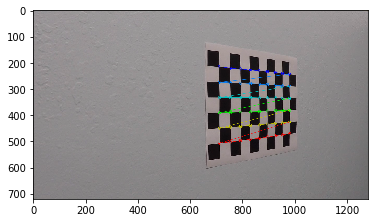

In [4]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
cal_files = glob.glob('../camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in cal_files:
    cal_img = cv2.imread(fname)
    cal_gray = cv2.cvtColor(cal_img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(cal_gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cal_img = cv2.drawChessboardCorners(cal_img, (9,6), corners, ret)
        plt.imshow(cal_img)
    else:
        print(fname, "could not find corners")

In [5]:
cal_img = mpimg.imread(cal_files[0]) # this image is loaded just to get the shape (we assume all images have the same shape)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, cal_img.shape[1::-1], None, None)

# Call cv2.undistort() with theses values
print("Calibration Matrix:\n{} \n\nDistortion Coefficients:\n{}".format(mtx, dist))

Calibration Matrix:
[[1.15777818e+03 0.00000000e+00 6.67113857e+02]
 [0.00000000e+00 1.15282217e+03 3.86124583e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]] 

Distortion Coefficients:
[[-0.24688507 -0.02373155 -0.00109831  0.00035107 -0.00259867]]


### Apply Distortion Correction 

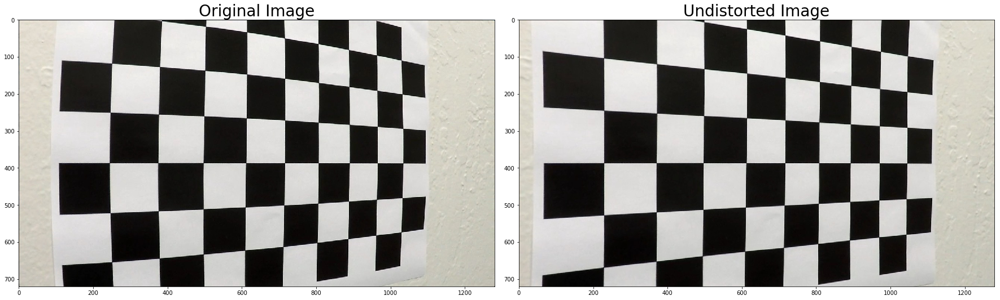

In [6]:
# Test out distortion correction on calibration image
cal_img = mpimg.imread(cal_files[0])
cal_img_undist = cv2.undistort(cal_img, mtx, dist, None, mtx)

plot2(cal_img, cal_img_undist, "Original Image", "Undistorted Image")

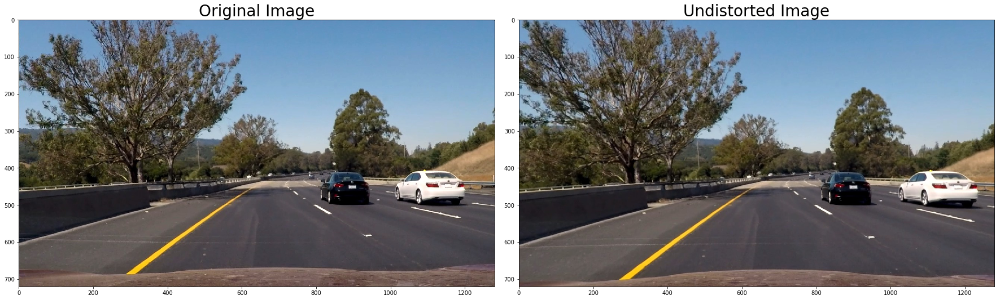

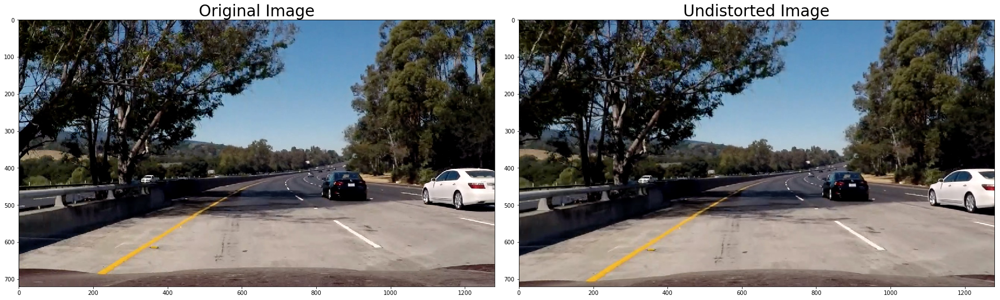

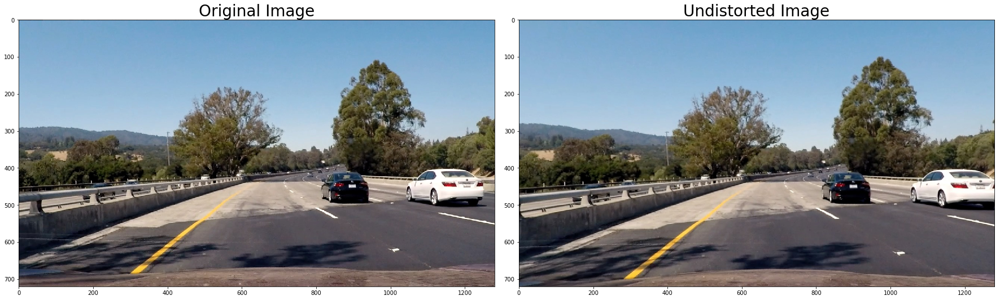

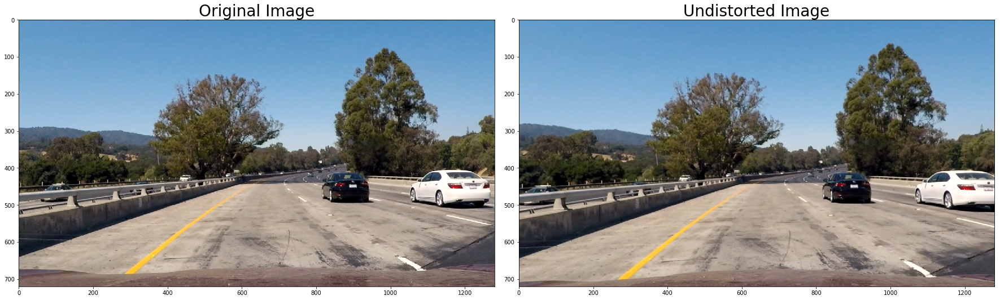

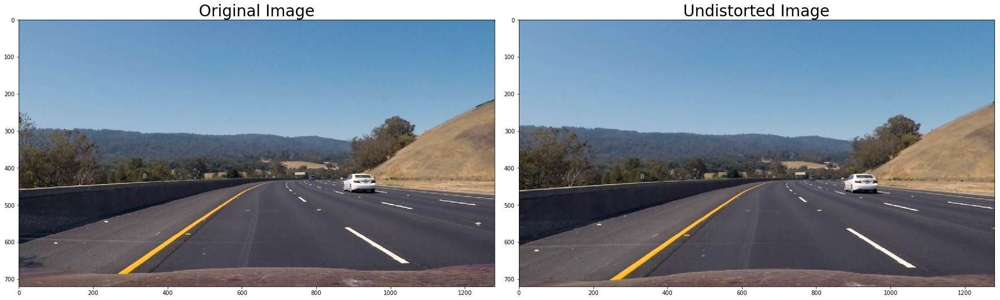

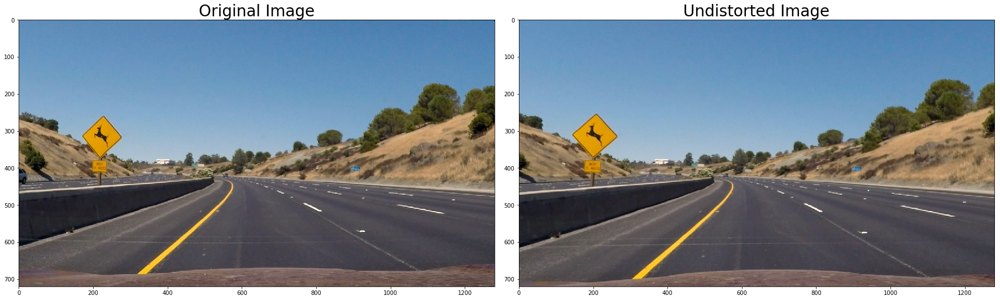

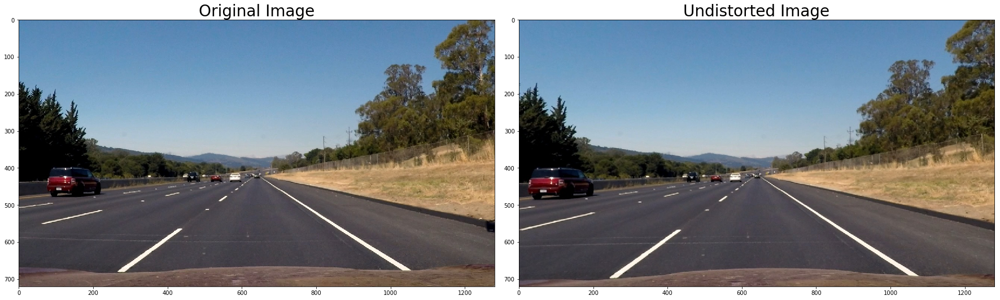

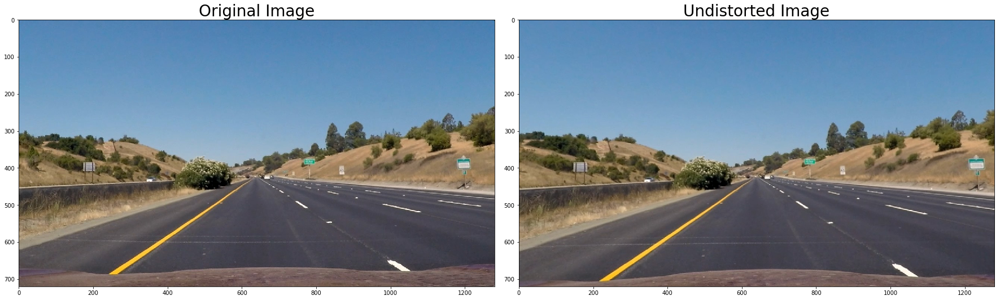

In [7]:
# Perform on test images from on-board camera
test_files = glob.glob('../test_images/*.jpg')

for test_file in test_files:
    test_img = mpimg.imread(test_file)
    test_img_undist = cv2.undistort(test_img, mtx, dist, None, mtx)

    plot2(test_img, test_img_undist, "Original Image", "Undistorted Image")

## Create Thresholded Binary Image

In [8]:
# Calculate directional gradient
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    dir = (int(orient == 'x'), int(orient == 'y'))
    
    sobelx = cv2.Sobel(gray_img, cv2.CV_64F, *dir, ksize=sobel_kernel)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobel = np.uint8(255 * abs_sobelx / np.max(abs_sobelx))
    
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return binary_output

In [9]:
# Calculate gradient magnitude
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    sobelx = cv2.Sobel(gray_img, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray_img, cv2.CV_64F, 0, 1)
    
    abs_sobel = np.sqrt(np.power(sobelx, 2) + np.power(sobely, 2))    
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    
    return binary_output

In [10]:
# Calculate gradient direction
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    sobelx = cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    abs_sobely = np.absolute(sobely)
    abs_sobelx = np.absolute(sobelx)
    
    abs_sobel = np.sqrt(np.power(sobelx, 2) + np.power(sobely, 2))
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    
    grad_dir = np.arctan2(abs_sobely, abs_sobelx)
    
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(grad_dir >= thresh[0]) & (grad_dir <= thresh[1])] = 1
    
    return binary_output

In [11]:
# Choose a Sobel kernel size
ksize = 3 # Choose a larger odd number to smooth gradient measurements

In [12]:
# Apply each of the thresholding functions
image = mpimg.imread(test_files[1])

gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(20, 100))
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(np.pi/6, np.pi/3))

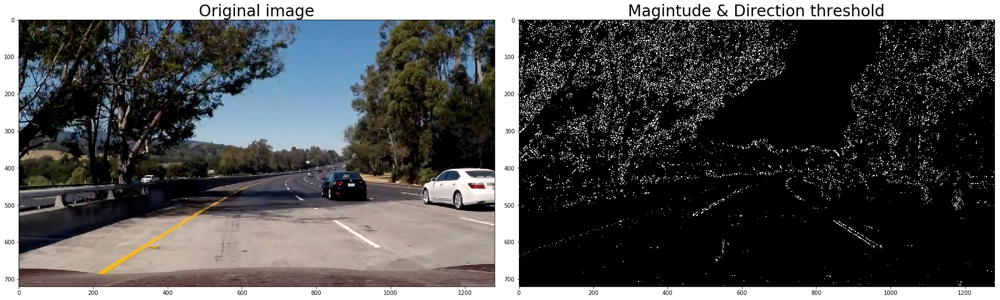

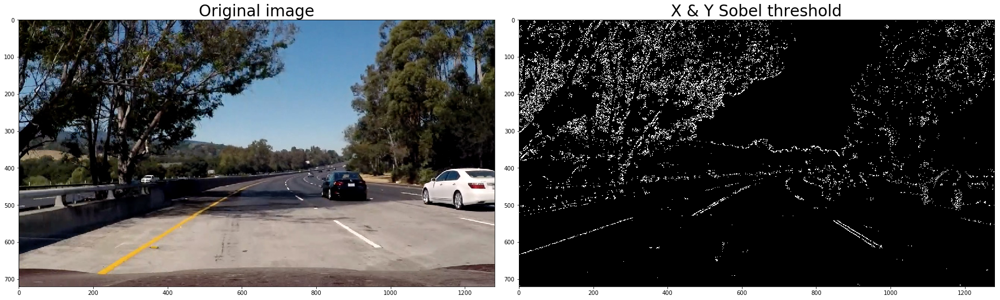

In [13]:
combined1 = np.zeros_like(dir_binary)
combined2 = np.zeros_like(dir_binary)
combined1[((mag_binary == 1) & (dir_binary == 1))] = 1
combined2[((gradx == 1) & (grady == 1))] = 1

plot2(image, combined1, title_left='Original image', title_right='Magintude & Direction threshold', args_right={ 'cmap': 'gray'})
plot2(image, combined2, title_left='Original image', title_right='X & Y Sobel threshold', args_right={ 'cmap': 'gray'})

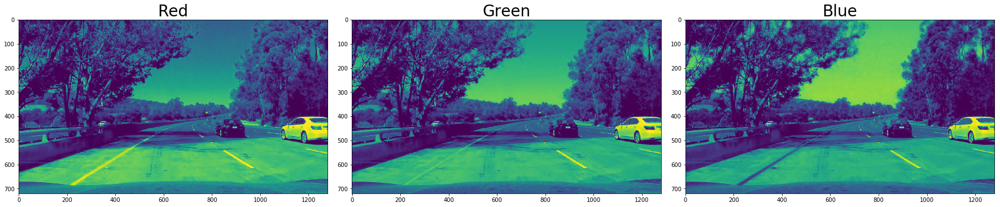

In [14]:
r = image[:,:,0]
g = image[:,:,1]
b = image[:,:,2]

plot3(r, g, b, title_left='Red', title_mid='Green', title_right='Blue')

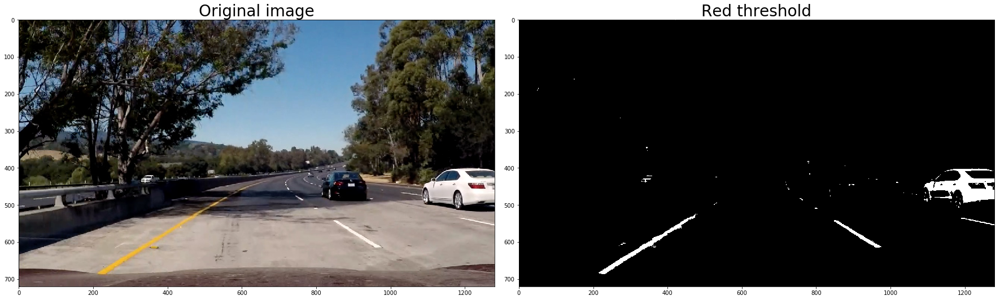

In [15]:
thresh = (210, 255)

red_thresh_binary = np.zeros_like(r)
red_thresh_binary[(r > thresh[0]) & (r <= thresh[1])] = 1

plot2(image, red_thresh_binary, title_left='Original image', title_right='Red threshold', args_right={'cmap': 'gray'})

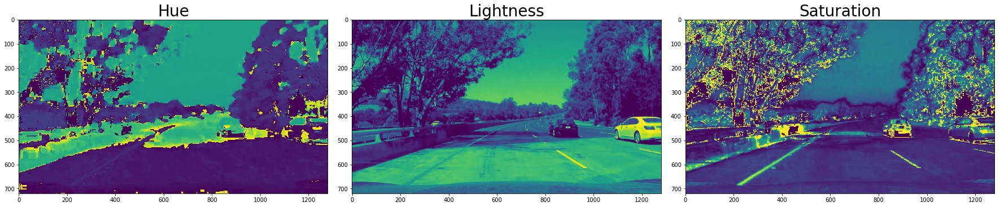

In [16]:
hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
h = hls[:,:,0]
l = hls[:,:,1]
s = hls[:,:,2]

plot3(h, l, s, title_left='Hue', title_mid='Lightness', title_right='Saturation')
# plot2(image, s, title_left='Original Image', title_right='Saturation', args_right={'cmap': 'gray'})

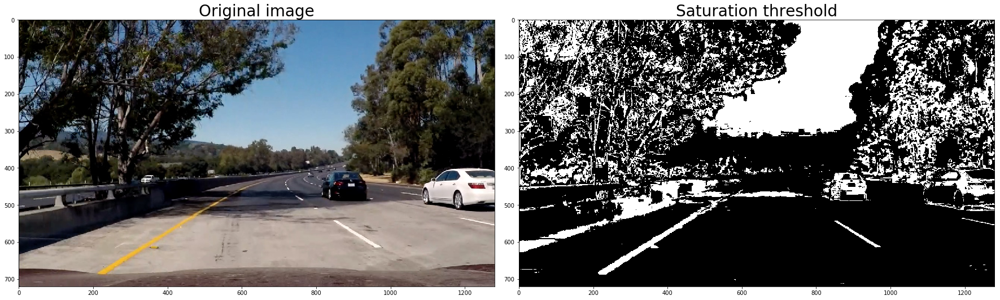

In [17]:
thresh = (90, 255)
binary_s = np.zeros_like(s)
binary_s[(s > thresh[0]) & (s <= thresh[1])] = 1

plot2(image, binary_s, title_left='Original image', title_right='Saturation threshold', args_right={ 'cmap': 'gray'})

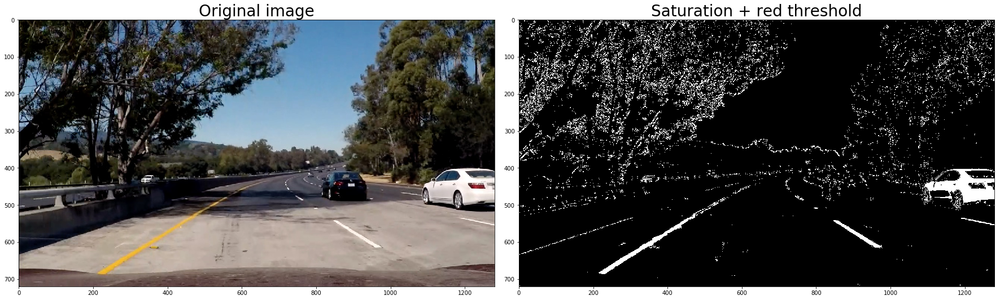

In [18]:
combined_all = np.zeros_like(binary_s)
combined_all[(red_thresh_binary == 1) | ((binary_s == 1) & (mag_binary == 1) & (dir_binary == 1)) | ((gradx == 1) & (grady == 1))] = 1

plot2(image, combined_all, title_left='Original image', title_right='Saturation + red threshold', args_right={ 'cmap': 'gray'})

In [19]:
def binary_from_threshold(channel, thresh):
    binary_image = np.zeros_like(channel)
    binary_image[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return binary_image

# Combine thresholds and apply region of interest
def binary_threshold(image):
    # X&Y Sobel + magnitude + direction
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(10, 200))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(10, 200))
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(20, 100))
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(np.pi/6,np.pi/3))#(0.7, 1.3))
    
    # Threshold on RED
    red = image[:,:,0]
    # green = image[:,:,1]
    # binary_green = binary_from_threshold(green, thresh=(150, 255))
    binary_red = binary_from_threshold(red, thresh=(150, 255))
    
    # Threshold on SATURATION
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    s = hls[:,:,2]
    l = hls[:,:,1]
    binary_lum = binary_from_threshold(l, thresh=(125, 255))
    binary_sat = binary_from_threshold(s, thresh=(90, 255))

    # combine RED and SATURATION
    combined = np.zeros_like(s)
    combined[(binary_red == 1) & (binary_lum == 1) & ((binary_sat == 1) | ((gradx == 1) & (grady == 1)))] = 1
            
    mask = np.zeros_like(combined)
    region_of_interest_vertices = np.array([[0, image.shape[0]-1], 
                                            [int(0.5*image.shape[1]), int(0.5*image.shape[0])], 
                                            [image.shape[1]-1, image.shape[0]-1]], dtype=np.int32)
    cv2.fillPoly(mask, [region_of_interest_vertices], 1)
    masked = cv2.bitwise_and(combined, mask)
    
    return masked

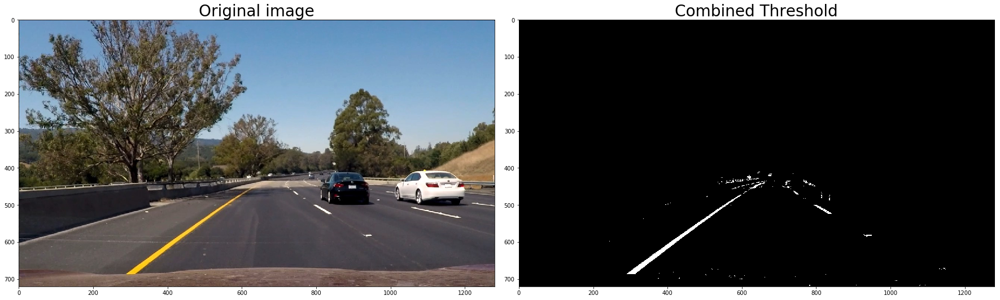

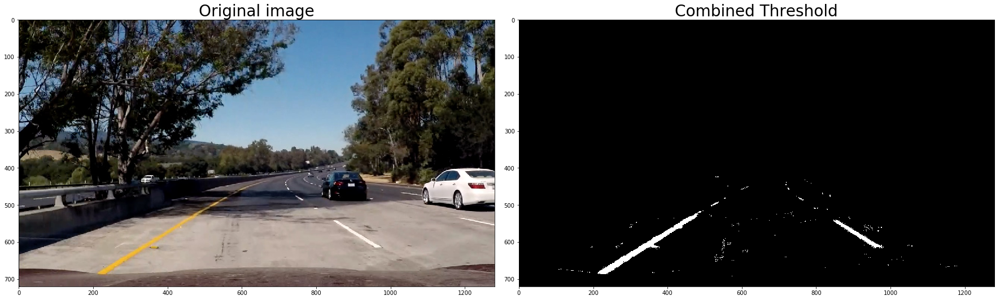

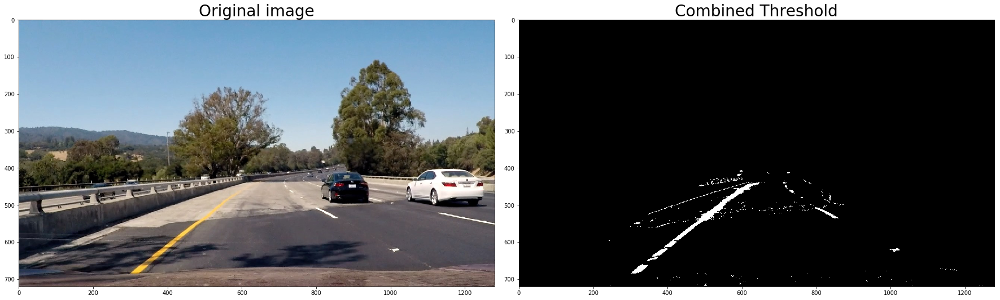

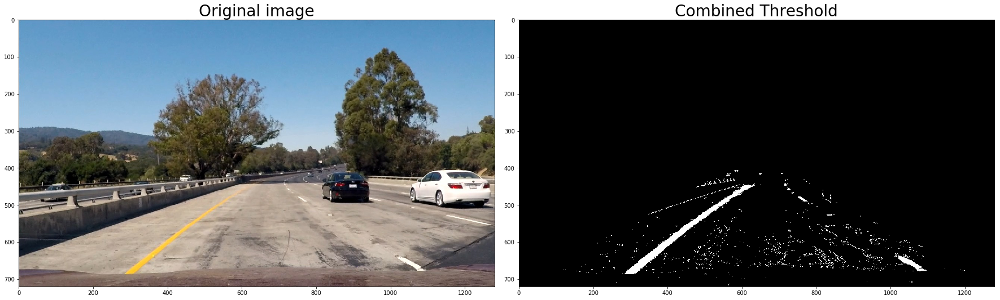

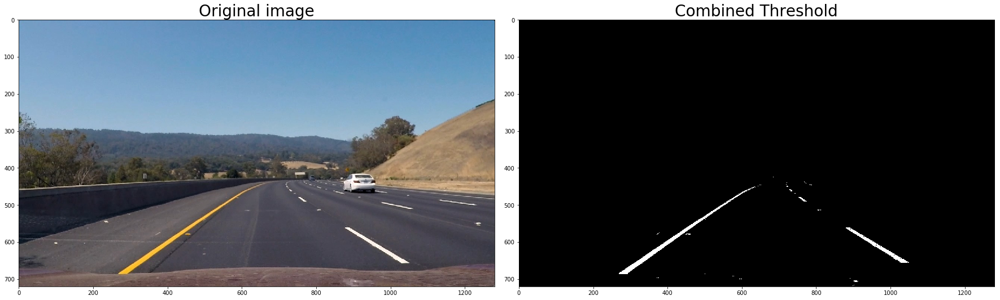

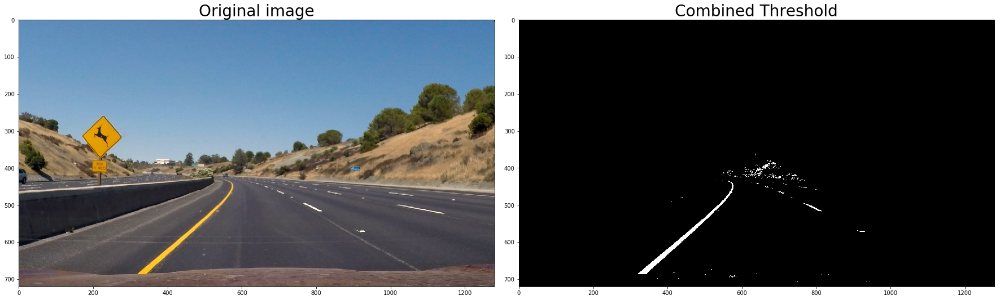

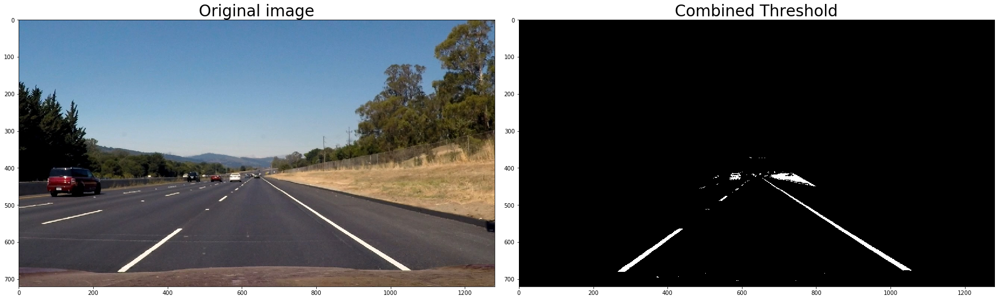

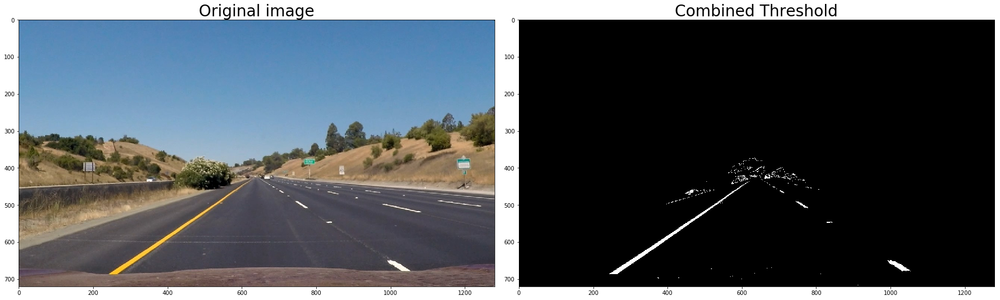

In [21]:
test_files = glob.glob('../test_images/*.jpg')

for test_file in test_files:
    test_img = mpimg.imread(test_file)
    
    
    binary_threshold_img = binary_threshold(test_img)
    plot2(test_img, binary_threshold_img, title_left='Original image', title_right='Combined Threshold', args_right={ 'cmap': 'gray'})
    binary_threshold_img = np.zeros_like(binary_threshold_img)

## Perspective Transform

In [22]:
src_points = np.float32([[600, 450], [680, 450], [1050, 680], [250, 680]])
# dst_points = np.float32([[400, 0], [800, 0], [800, 720], [400, 720]])
dst_points = np.float32([[300, 0], [900, 0], [900, 720], [300, 720]])
M = cv2.getPerspectiveTransform(src_points, dst_points)
Minv = cv2.getPerspectiveTransform(dst_points, src_points)

def warp_image(img):
    return cv2.warpPerspective(img, M, img.shape[1::-1], flags=cv2.INTER_LINEAR)

def unwarp_image(img):
    return cv2.warpPerspective(img, Minv, img.shape[1::-1], flags=cv2.INTER_LINEAR)

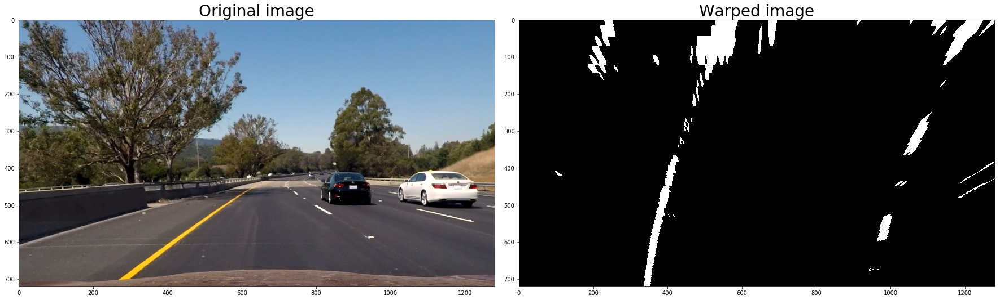

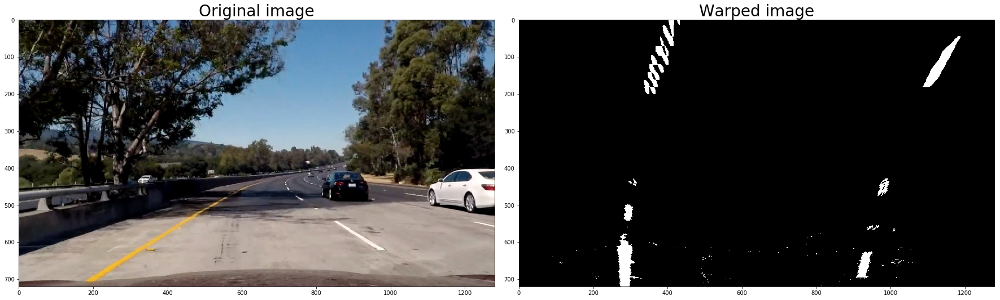

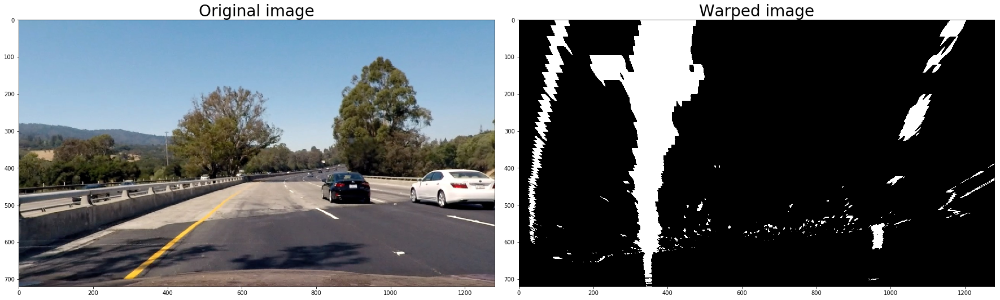

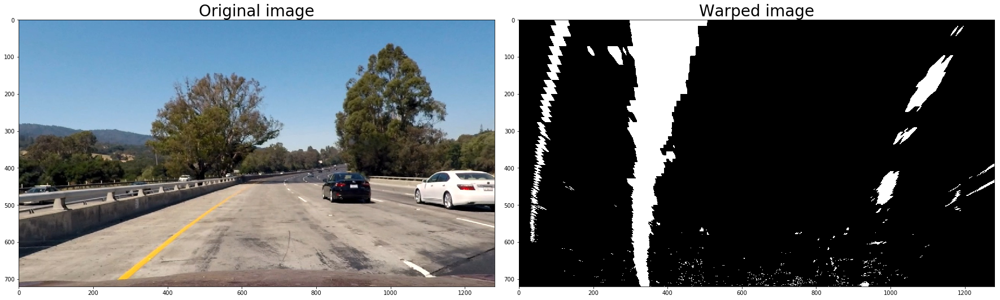

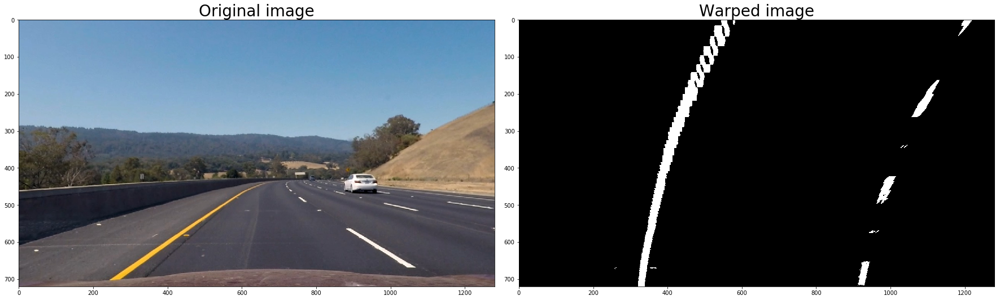

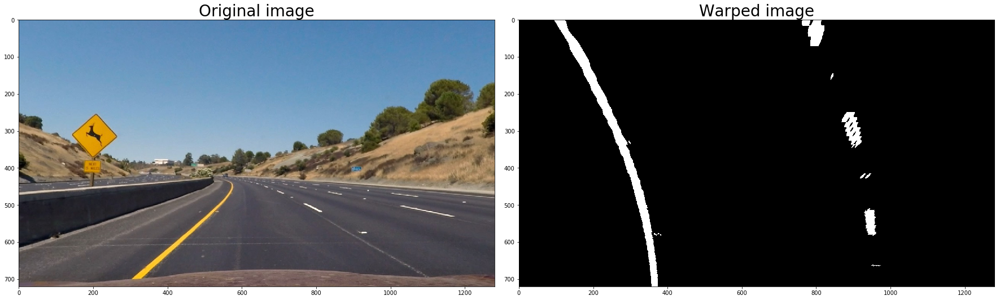

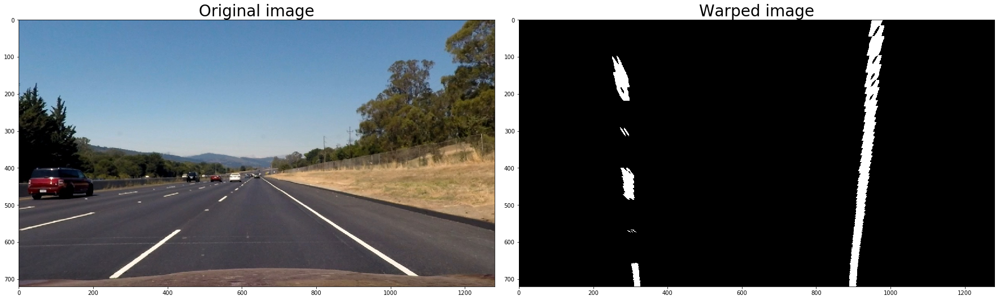

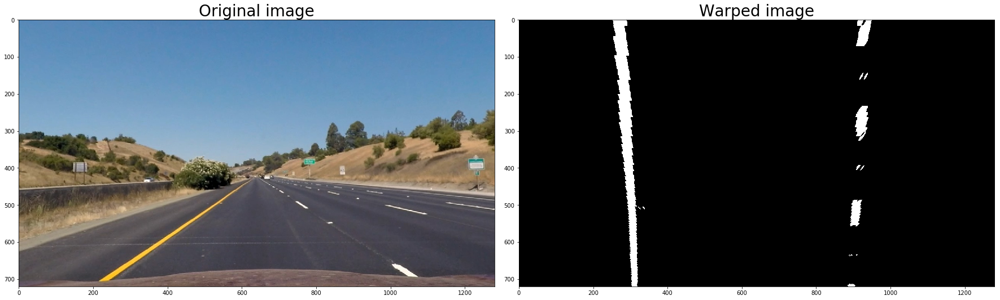

In [23]:
test_files = glob.glob('../test_images/*.jpg')

for test_file in test_files:
    test_img = mpimg.imread(test_file)
    undistorted_img = cv2.undistort(test_img, mtx, dist, None, mtx)
    binary_threshold_img = binary_threshold(undistorted_img)
    
    warped_img = warp_image(binary_threshold_img)
    plot2(undistorted_img, warped_img, 
          title_left="Original image", title_right="Warped image", 
          args_right={'cmap': 'gray'})

## Finding Lanes

In [24]:
# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

In [25]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

In [26]:
def plot_window_fitting(warped_img, window_centroids):
    # If we found any window centers
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped_img)
        r_points = np.zeros_like(warped_img)

        # Go through each level and draw the windows 
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width, window_height, warped_img, window_centroids[level][0], level)
            r_mask = window_mask(window_width, window_height, warped_img, window_centroids[level][1], level)

            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points + l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel, template, zero_channel)), np.uint8) # make window pixels green
        warpage= np.dstack((warped_img, warped_img, warped_img)) * 255 # making the original road pixels 3 color channels
        return cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just display orginal road image
    else:
        return np.array(cv2.merge((warped_img, warped_img, warped_img)), np.uint8)

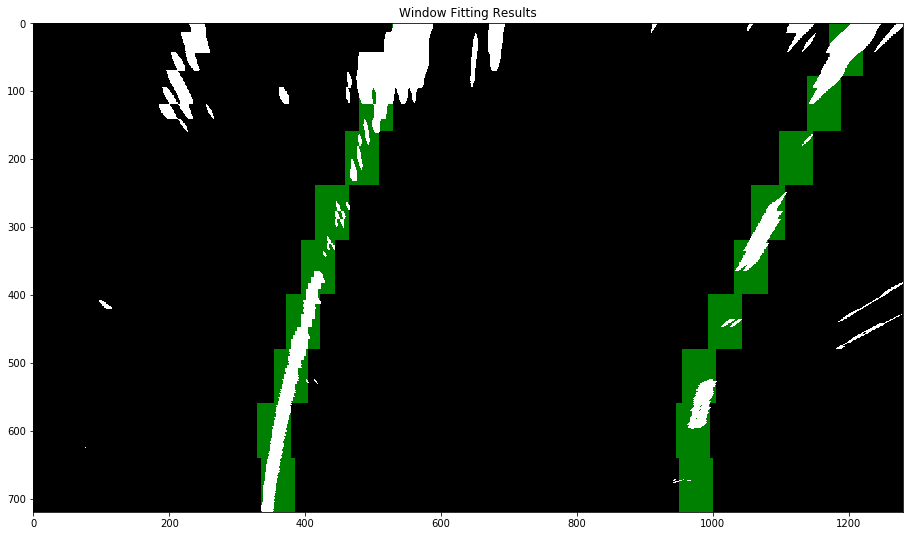

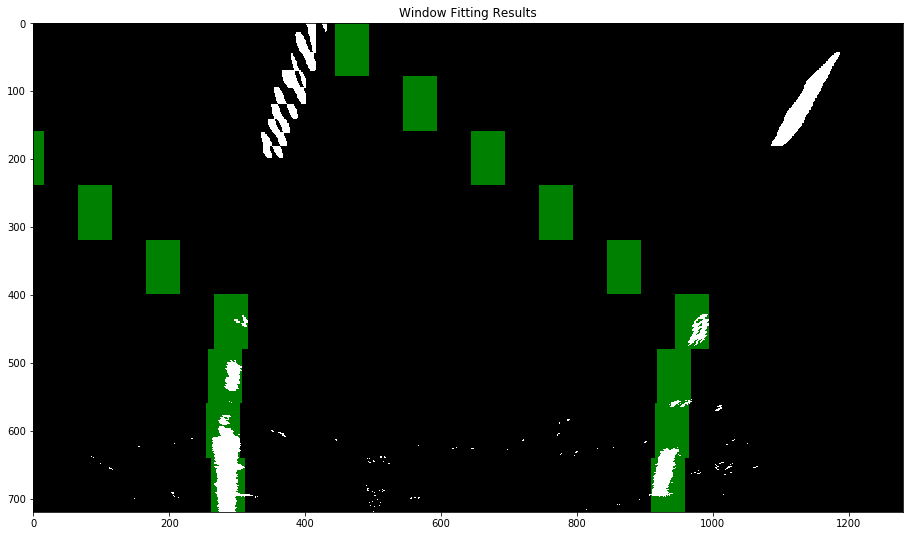

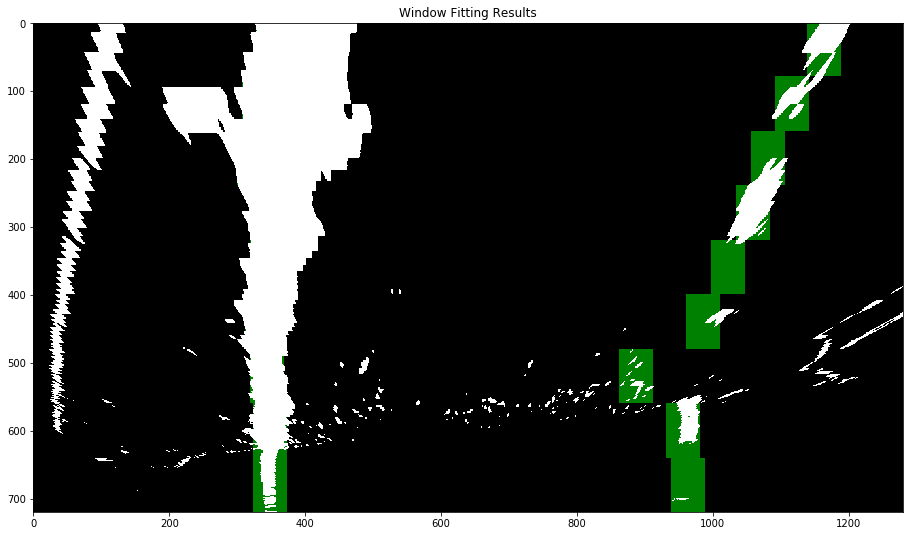

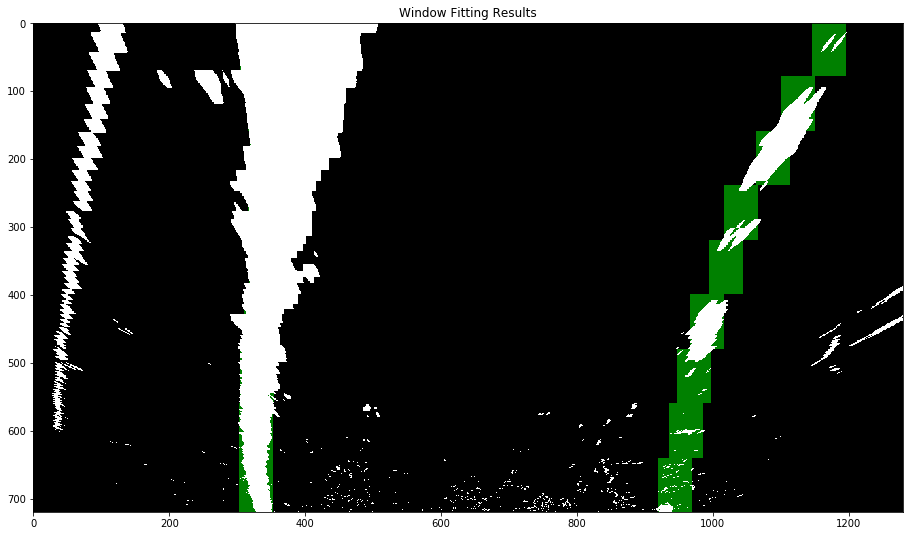

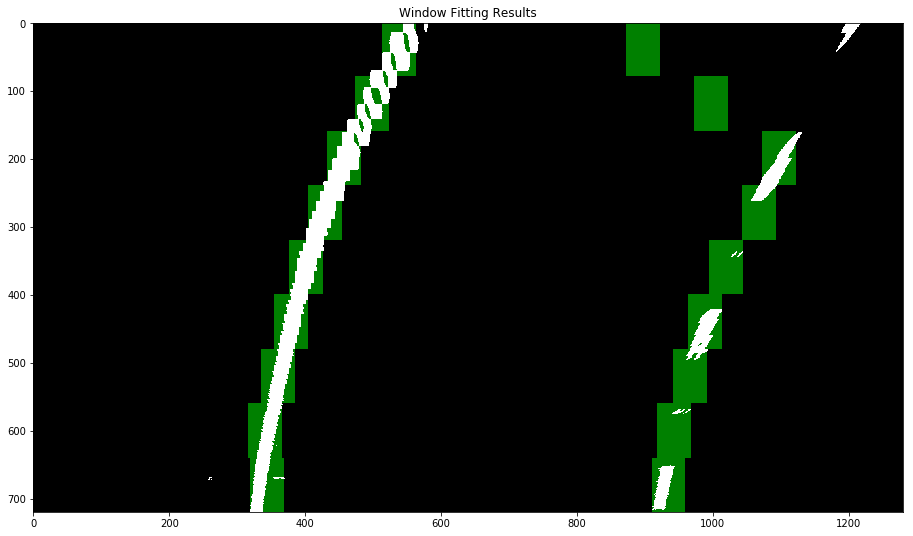

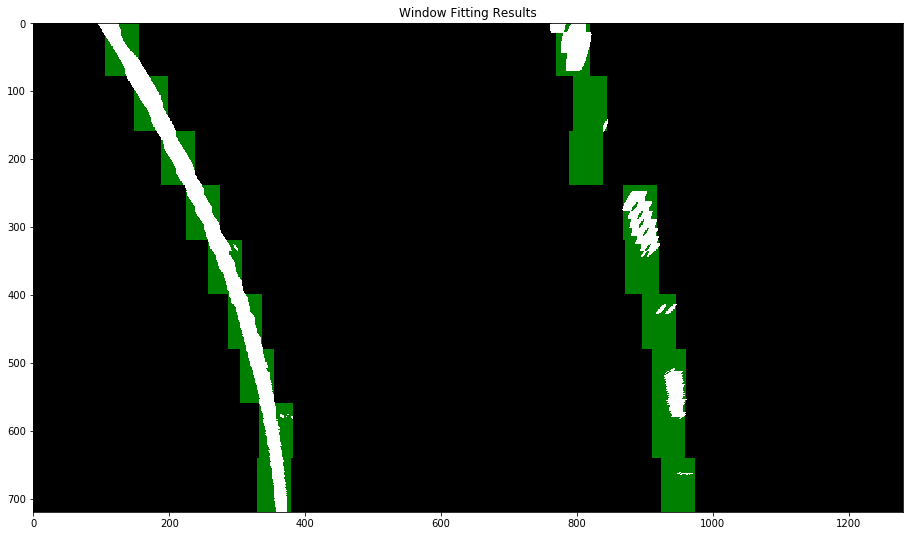

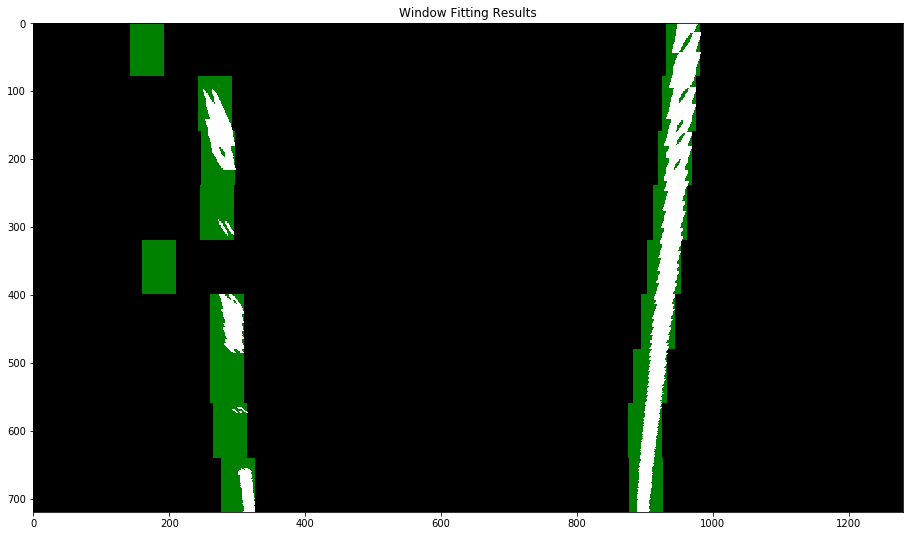

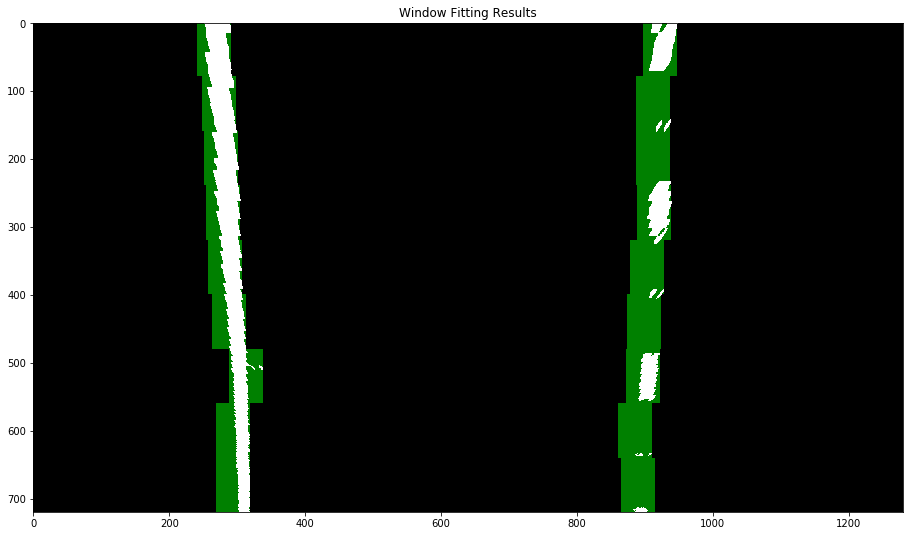

In [27]:
test_files = glob.glob('../test_images/*.jpg')

for test_file in test_files:
    test_img = mpimg.imread(test_file)
    undistorted_img = cv2.undistort(test_img, mtx, dist, None, mtx)
    binary_threshold_img = binary_threshold(undistorted_img)

    warped_img = warp_image(binary_threshold_img)
    window_centroids = find_window_centroids(warped_img, window_width, window_height, margin)
    
    window_img = plot_window_fitting(warped_img, window_centroids)
    
    # Display the final results
    plt.figure(figsize=(16,9))
    plt.imshow(window_img)
    plt.title('Window Fitting Results')
    plt.show()

In [28]:
def sliding_window_search(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return (left_lane_inds, right_lane_inds, left_fit, right_fit, nonzerox, nonzeroy)

In [29]:
def find_fitted_lines(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []# Step through the windows one by one
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high), (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high), (0,255,0), 2) 

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # PLOTTING
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    return left_fit, right_fit, left_fitx, right_fitx, ploty, out_img

In [31]:
def find_fitted_lines_next_frame(binary_warped, left_fit, right_fit, left_fitx, right_fitx, ploty):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)

    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return left_fitx, right_fitx, ploty, result

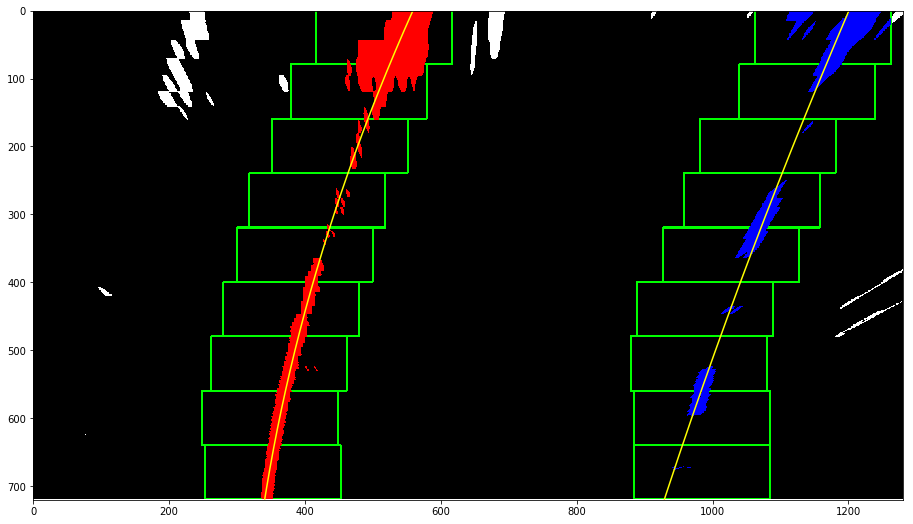

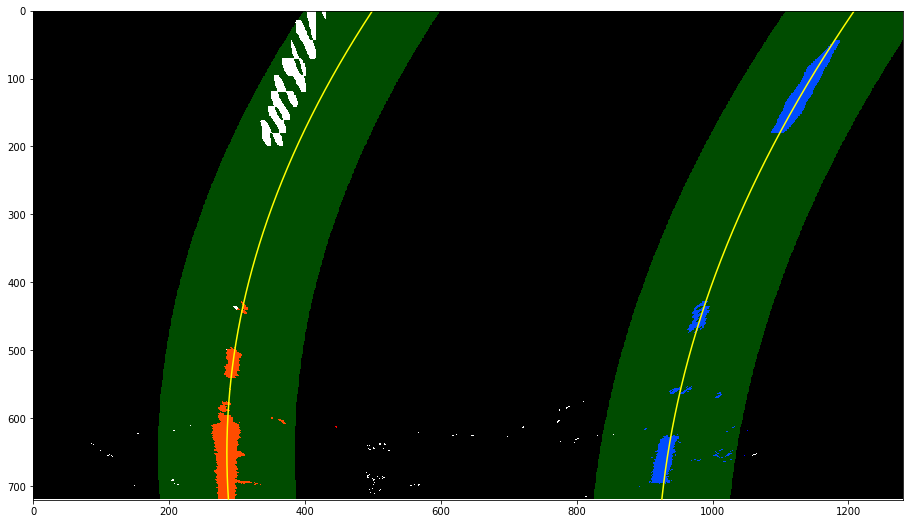

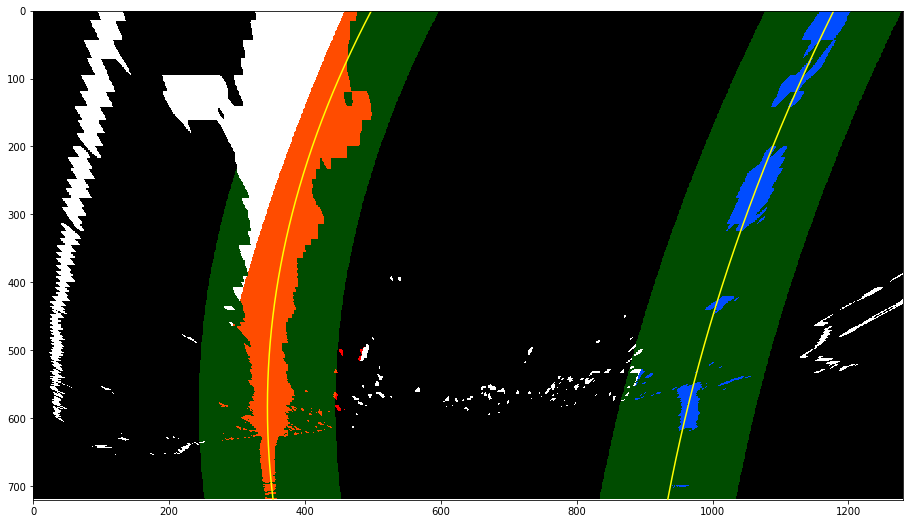

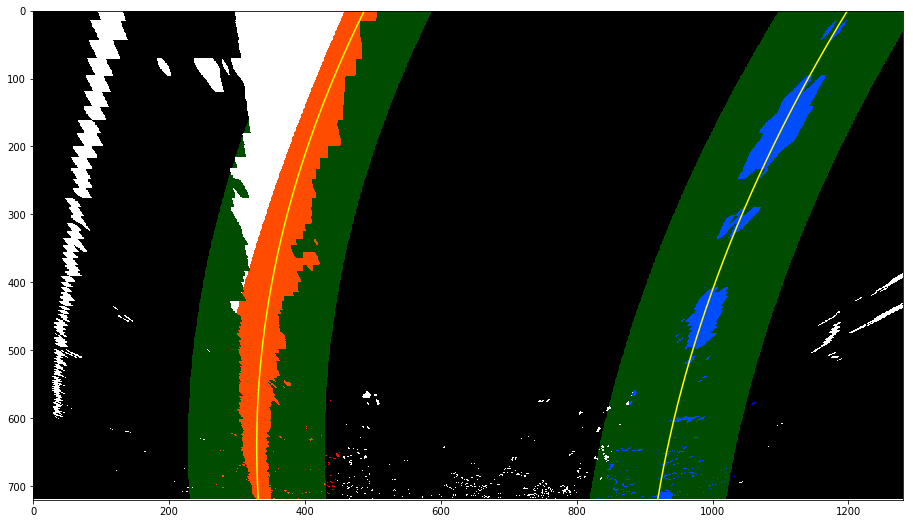

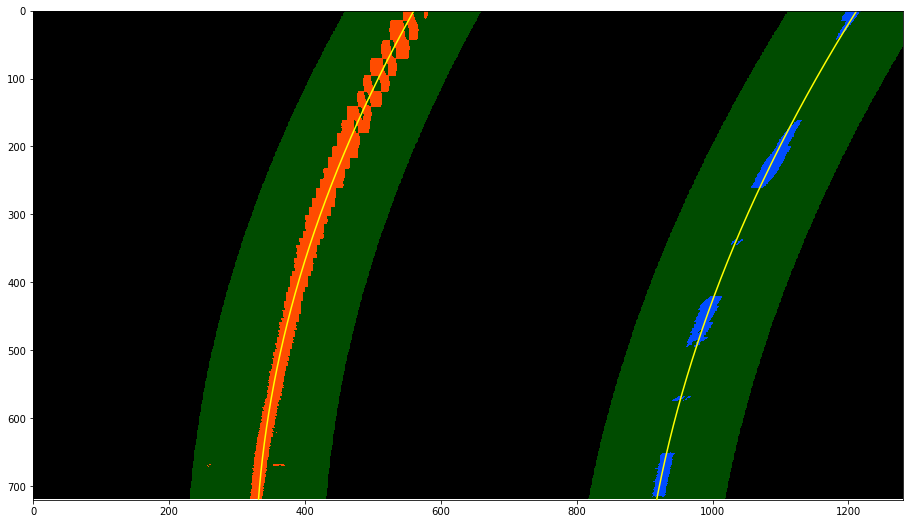

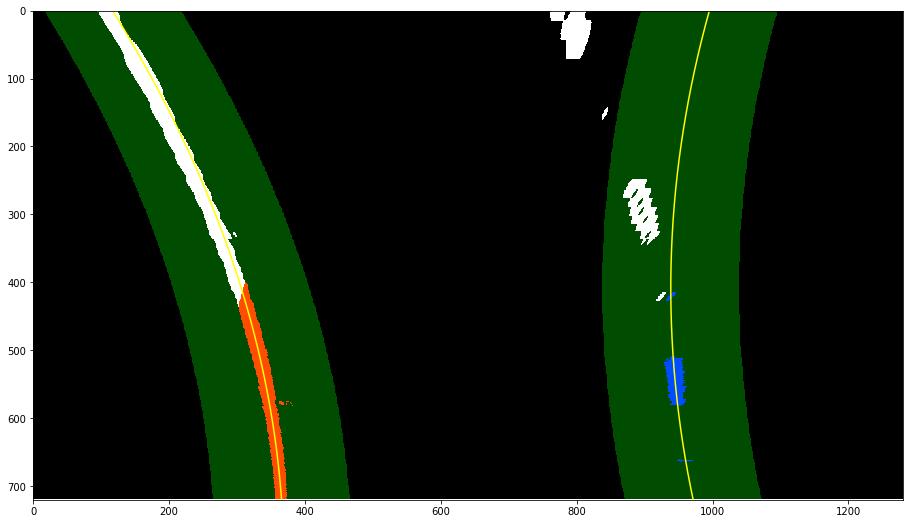

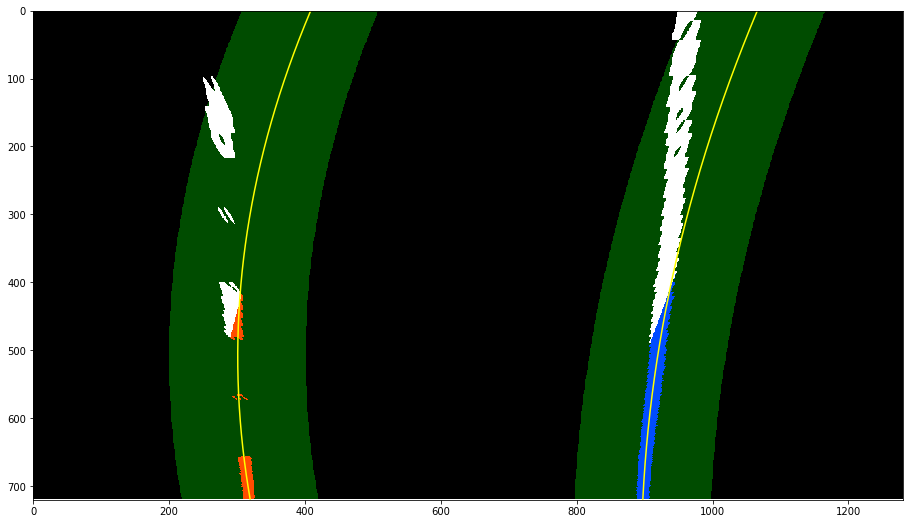

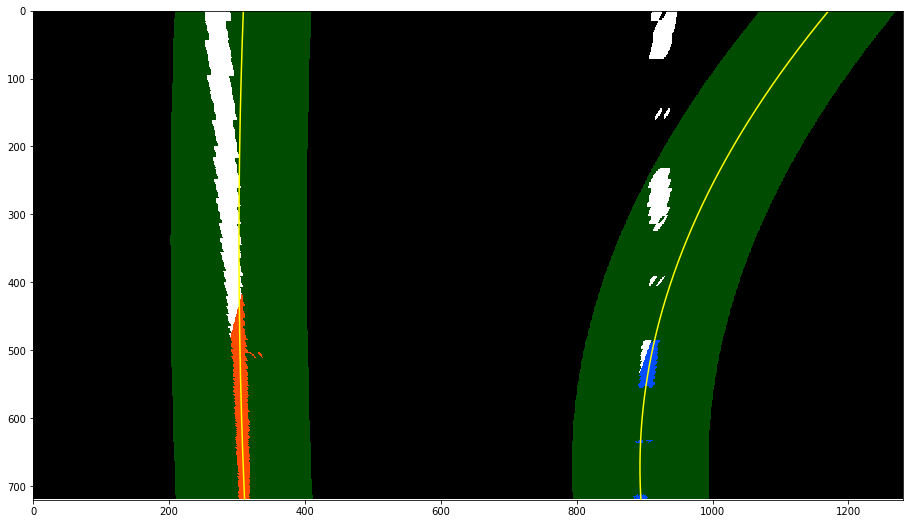

In [32]:
test_files = glob.glob('../test_images/*.jpg')

for index, test_file in enumerate(test_files):
    test_img = mpimg.imread(test_file)
    undistorted_img = cv2.undistort(test_img, mtx, dist, None, mtx)
    binary_threshold_img = binary_threshold(undistorted_img)

    warped_img = warp_image(binary_threshold_img)
    if index == 0:
        left_fit, right_fit, left_fitx, right_fitx, ploty, result = find_fitted_lines(warped_img)
    else:
        left_fitx, right_fitx, ploty, result = find_fitted_lines_next_frame(warped_img, left_fit, right_fit, left_fitx, right_fitx, ploty)
        
    plt.figure(figsize=(16,9))
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

In [33]:
def get_lane_overlay(image, binary_threshold, left_fitx, right_fitx, ploty, Minv):
    warp_zero = np.zeros_like(binary_threshold).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]),False,(0,0,255),thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]),False,(255,0,),thickness=20)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)

    return result

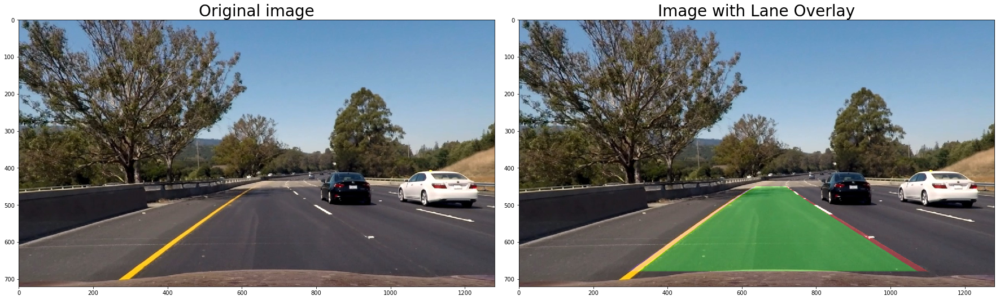

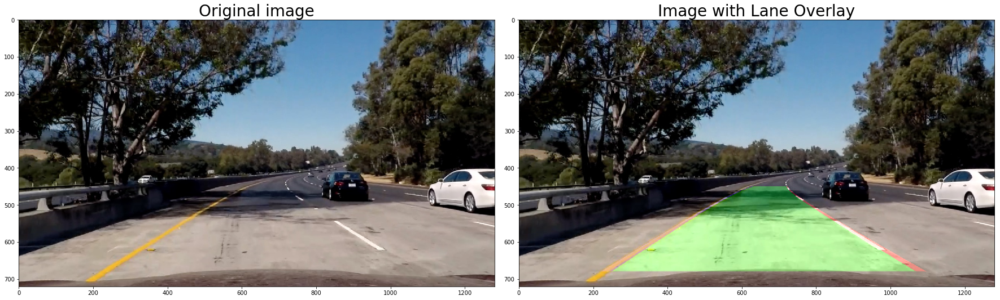

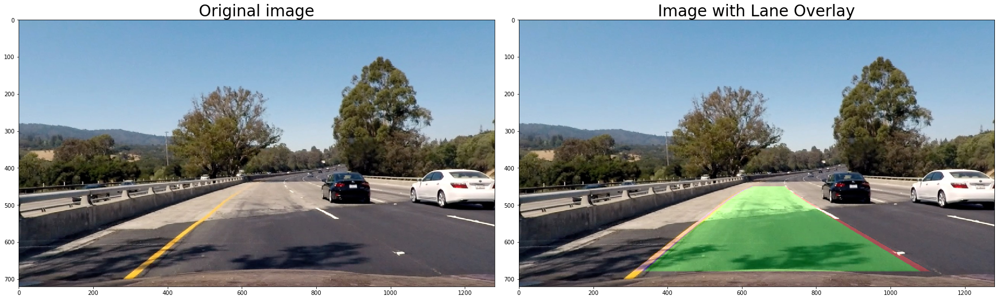

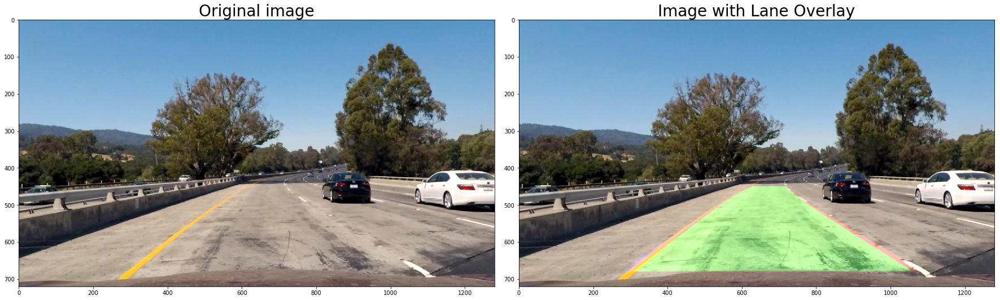

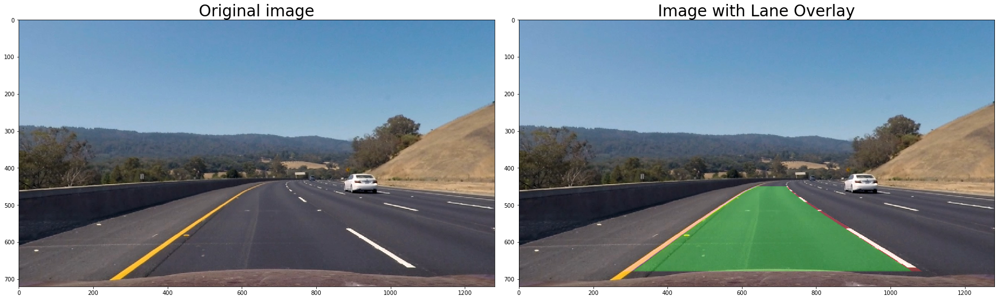

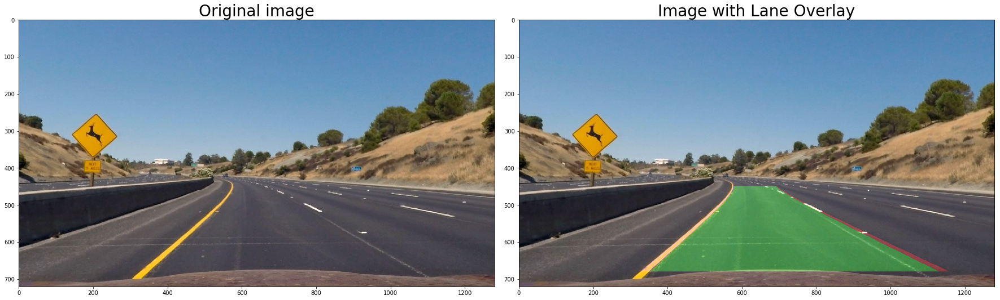

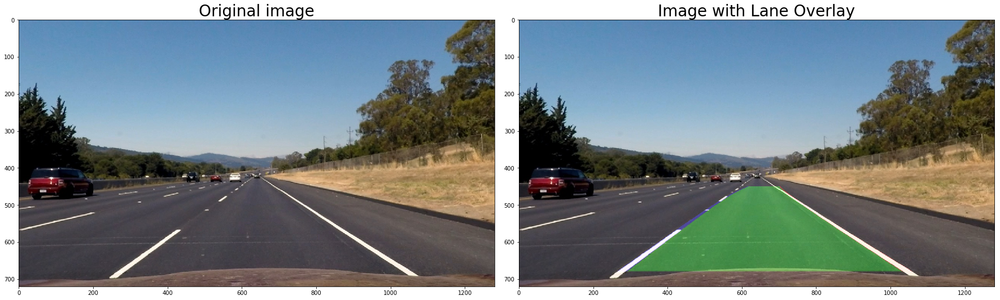

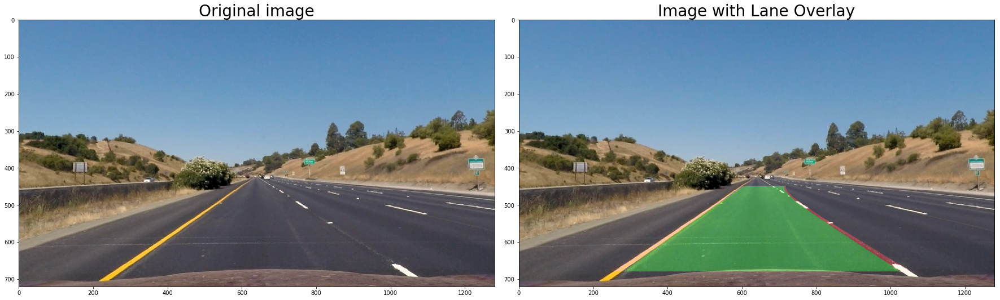

In [34]:
test_files = glob.glob('../test_images/*.jpg')

for index, test_file in enumerate(test_files):
    test_img = mpimg.imread(test_file)
    undistorted_img = cv2.undistort(test_img, mtx, dist, None, mtx)
    binary_threshold_img = binary_threshold(undistorted_img)

    warped_img = warp_image(binary_threshold_img)
    if index == 0:
        left_fit, right_fit, left_fitx, right_fitx, ploty, _ = find_fitted_lines(warped_img)
    else:
        left_fitx, right_fitx, ploty, result = find_fitted_lines_next_frame(warped_img, left_fit, right_fit, left_fitx, right_fitx, ploty)
        
    lane_overlay_img = get_lane_overlay(undistorted_img, binary_threshold_img, left_fitx, right_fitx, ploty, Minv)
    plot2(undistorted_img, lane_overlay_img, title_left="Original image", title_right="Image with Lane Overlay")
    